TAREA 2: Visualizacion de datos 2024-1 
- Nombre: Nicolas Esteban Parra Garcia  
- Matricula: 2019422588

# Load data

## Imports

In [1]:
import pandas as pd
import plotly.express as px
from pywaffle import Waffle
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import numpy as np
import os
import plotly.graph_objects as go

In [2]:
#para que se guarden los graficos de plotly en html
import plotly.io as pio
pio.renderers.default='notebook'


## DataFrames 

In [3]:
# df_gapminder para las preguntas 1, 2 y 3
df_gapminder = pd.read_csv('gapminderData2.csv')
# df_migrantes_chile para la pregunta 4 y 5
df_migrantes_chile = pd.read_excel('MigrantesChile (2005-2016).xlsx',
                      sheet_name='Migrantes',
                      skipfooter=3)
# df_songs para la pregunta 6
directory_path = 'archive/'
csv_files = [os.path.join(directory_path, f) for f in os.listdir(directory_path) if f.endswith('.csv')]
dataframes = []
for file in csv_files:
    df = pd.read_csv(file)
    dataframes.append(df)
df_songs = pd.concat(dataframes, ignore_index=True)

# Pregunta 1
A partir del dataset (A), obtenga un scatterplot que permita visualizar la relación entre PIB per Cápita y Nacimientos por Mujer, en el año 2007

In [4]:
df_2007 = df_gapminder[df_gapminder['year'] == 2007]
# se seleccionan los datos de la columna del dataset gapminder del año 2007
# se hace un scatter del dataframe df_2007, eje x es el PIB per cápita, eje y es el número de nacimientos por mujer
# color representa el continente respectivo, hover_name es el nombre del país (on-hover), escala logaritmica en el eje x para mejor visualizacion 
fig = px.scatter(df_2007, x='gdpPercap', y='bornPerwom', color='continent',
                 hover_name='country', 
                 log_x=True,
                 labels={
                     "gdpPercap": "PIB per Cápita",
                     "bornPerwom": "Nacimientos por Mujer"
                 },
                 title="Relación entre PIB per Cápita y Nacimientos por Mujer en 2007")

fig.show()

# Pregunta 2
 Transforme el gráfico anterior en un bubblechart, que considere la población de cada país como tamaño de la burbuja.

In [5]:
#Los parametros entregados son:
# df_2007 dataframe con los datos del año 2007, x es el gpd per capita, y es el numero de nacimientos por mujer, color es el continente,
# size es la poblacion, hover_name es el nombre del pais, log_x es escala logaritmica en el eje x, size_max es el tamaño maximo de la burbuja
# hover_name es el nombre del pais (on-hover),
fig = px.scatter(df_2007, x='gdpPercap', y='bornPerwom', color='continent',
                 size='pop', hover_name='country', 
                 log_x=True, size_max=60,
                 labels={
                     "gdpPercap": "PIB per Cápita",
                     "bornPerwom": "Nacimientos promedio por Mujer"
                 },
                 title="Relación entre PIB per Cápita y Nacimientos por Mujer en 2007 (con tamaño de burbuja representativo)")

fig.show()

# Pregunta 3
Realice una animación del bubblechart anterior en el tiempo, considerando todos los años del dataset (A).
Con plotly queda super facil.

In [6]:
# A partir de todo el dataset
# Se realiza un scatter con los siguientes parametros:
# animation_frame indica la columna que varia a traves del tiempo, en este caso es el año.
# el resto de los parametros son los mismos que en el scatter anterior
fig = px.scatter(df_gapminder, x='gdpPercap', y='bornPerwom', color='continent',
                 size='pop', hover_name='country', 
                 log_x=True, size_max=60,
                 animation_frame='year', 
                 labels={
                     "gdpPercap": "PIB per Cápita",
                     "bornPerwom": "Nacimientos promedio por Mujer"
                 },
                 title="Relación entre PIB per Cápita y Nacimientos promedio por Mujer a través de los años")

fig.show()

# Pregunta 4
Realice un Waffle Chart con el aporte de los 8 países europeos que más aportaron a la inmigración nacional, en un año determinado, a partir del dataset (B)

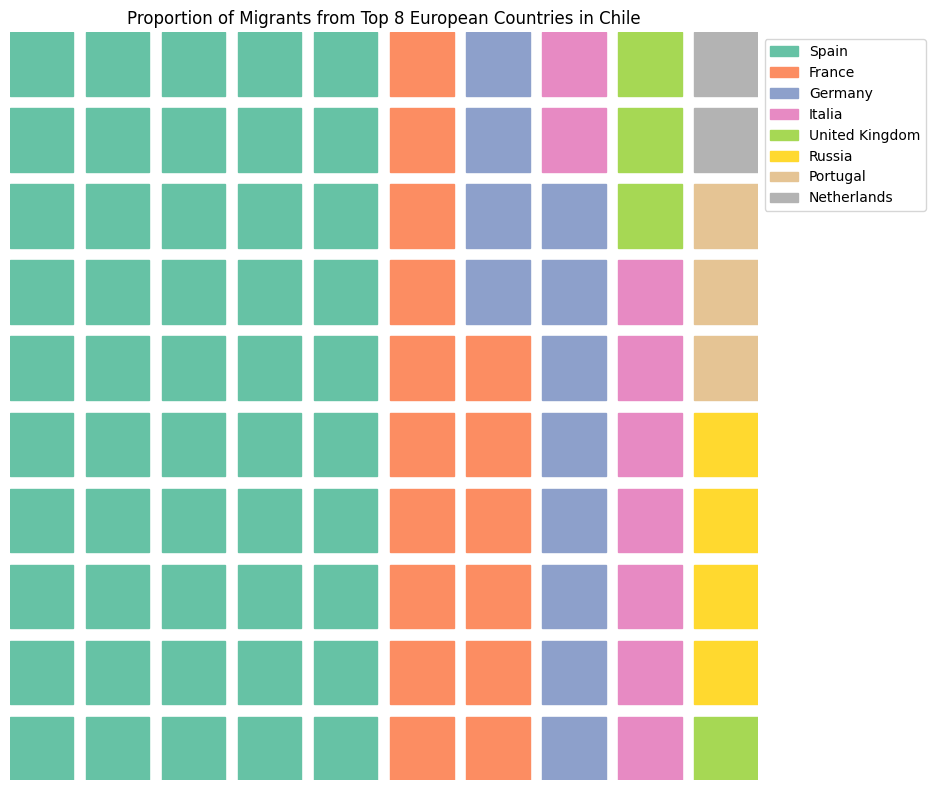

In [7]:
df_migrantes_chile.head()
# eliminar columnas innesesarias 
df_chi = df_migrantes_chile.drop(columns=['ID Continent', 'ID Country'])
#creacion de columna total
df_chi['Total'] = df_chi.select_dtypes(include=['number']).sum(axis=1)
# se obtienen los paises europeos y se ordenan por total 
df_chi_europe = df_chi[df_chi['Continent'] == 'Europe']
df_chi_europe = df_chi_europe.sort_values(by='Total', ascending=False).head(8)
# Se crea una figura de tipo Waffle con lo siguientes parametros:
# columns=10 y rows=10 establece una cuadrícula de 10x10 para el gráfico (tamaño arbitrario), values=waffle_data proporciona los datos para el gráfico, 
# title establece el título del gráfico y su ubicación
# legend configura la posición de la leyenda, figsize establece el tamaño de la figura
waffle_data = df_chi_europe.set_index('Country')['Total'].to_dict()
fig = plt.figure(
    FigureClass=Waffle, 
    columns=10,
    rows=10, 
    values=waffle_data,
    title={'label': 'Proportion of Migrants from Top 8 European Countries in Chile', 'loc': 'center'},
    legend={'loc': 'upper left', 'bbox_to_anchor': (1, 1)},
    figsize=(12, 8)  
)

plt.show()


# Pregunta 5
Realice un Heat Map años versus los cinco países europeos con más inmigrantes en total, para el dataset (B).

In [8]:
# del df anterior se obtienen los 5 primeros paises
df_chi_europe_top5 = df_chi_europe.head(5)
# Se transforma el DataFrame df_chi_europe_top5 de formato ancho a formato largo
df_pivot = df_chi_europe_top5.melt(id_vars='Country', var_name='Year', value_name='Immigrants')
# Se pivota el DataFrame para que los años sean las filas y los países sean las columnas
df_pivot = df_pivot.pivot(index='Year', columns='Country', values='Immigrants')

#se agregan los numeros y se aplica la escala logaritmica (para mejor visualizacion)
df_pivot = df_pivot.apply(pd.to_numeric, errors='coerce')
df_pivot.replace(0, 1e-9, inplace=True) 
log_df_pivot = np.log10(df_pivot)

# Se crea un gráfico de calor (heatmap) con los siguientes parametros:
# labels etiquetas personalizadas para los ejes y la barra de color
# color_continuous_scale='Viridis' escala de color continua Viridis para mejor visualización
fig = go.Figure(data=go.Heatmap(
    z=log_df_pivot.values,
    x=log_df_pivot.columns,
    y=log_df_pivot.index,
    colorscale='Viridis',
    colorbar=dict(title="Log of Number of Immigrants"),
    xgap=1, 
    ygap=1
))

fig.update_layout(
    title='Log scale Number of Immigrants from Top 5 European Countries in Chile by Year',
    xaxis_title='Country',
    yaxis_title='Year',
    yaxis=dict(tickmode='linear') 
)
fig.update_traces(text=df_pivot.map(lambda x: f'{x:.2f}').astype(str),
                  texttemplate="%{text}")

fig.show()

# Pregunta 6
Con el dataset (C), realice un Word Cloud de las letras de canciones de Taylor Swift. Excluya palabras destacadas que no correspondan a verbos, adjetivos o sustantivos.

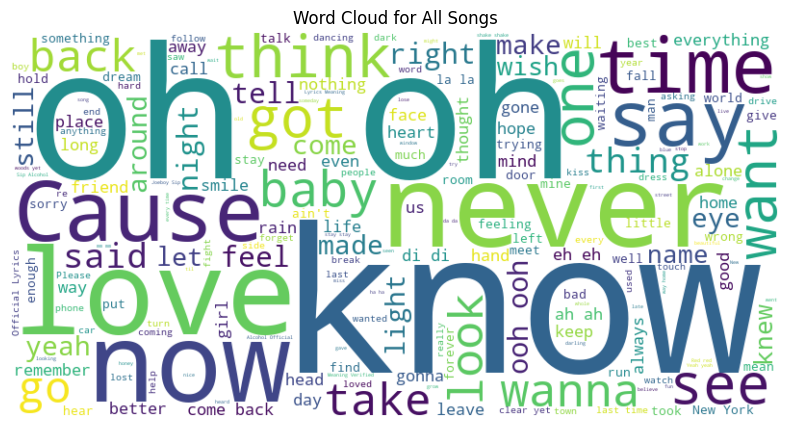

In [9]:
df_lyrics = df_songs[['track_title','lyric']]

# Combina todas las letras de todas las canciones en una sola cadena de texto
all_lyrics = ' '.join(df_songs['lyric'])

# Genera word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_lyrics)
# Se crea una instancia de WordCloud con los siguientes parametros:
# se usa la cadena all_lyrics, con ancho y alto especifico y fondo blanco
# Cabe mencionar que se wordCloud elimina automaticamente las hotwords

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title("Word Cloud for All Songs")
plt.axis('off')
plt.show()


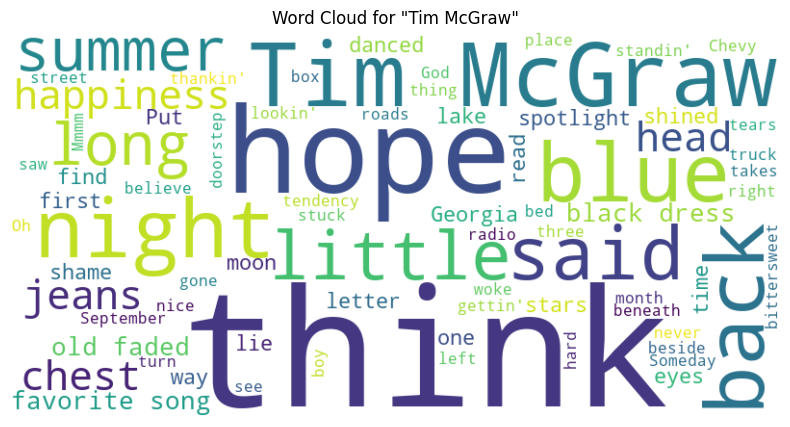

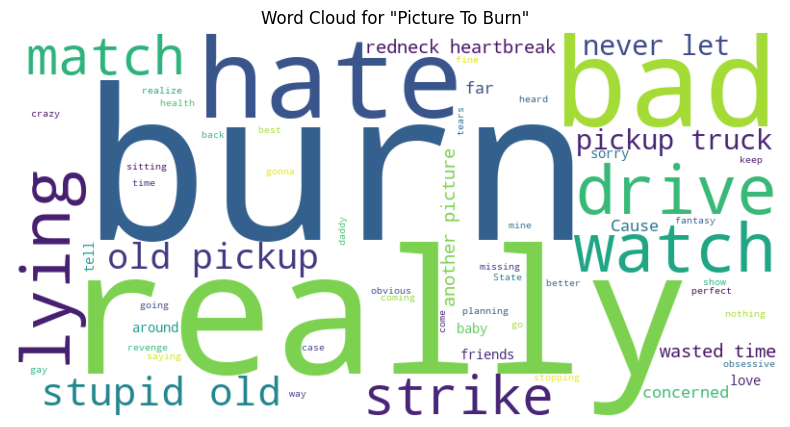

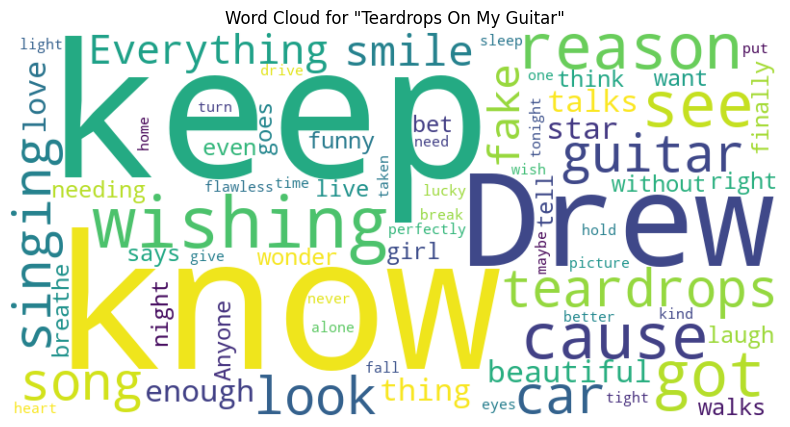

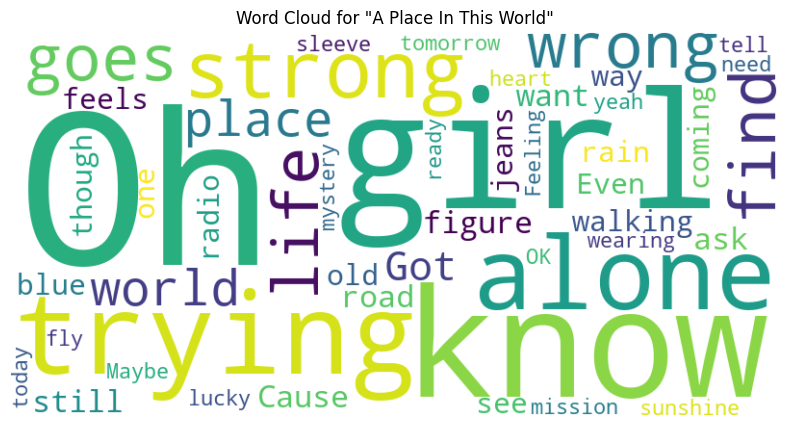

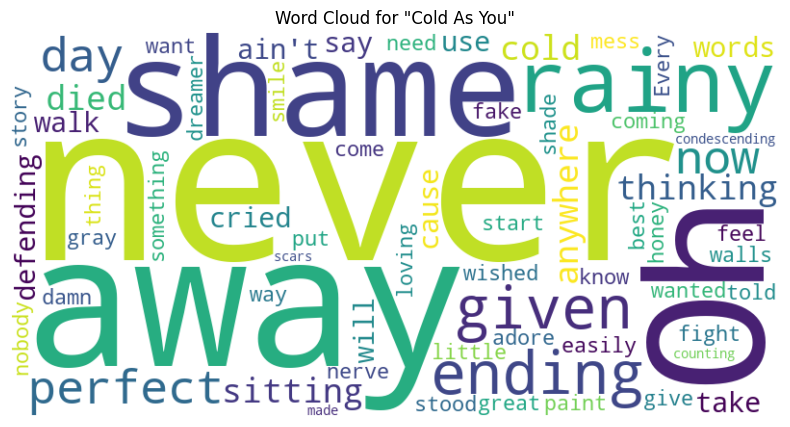

...

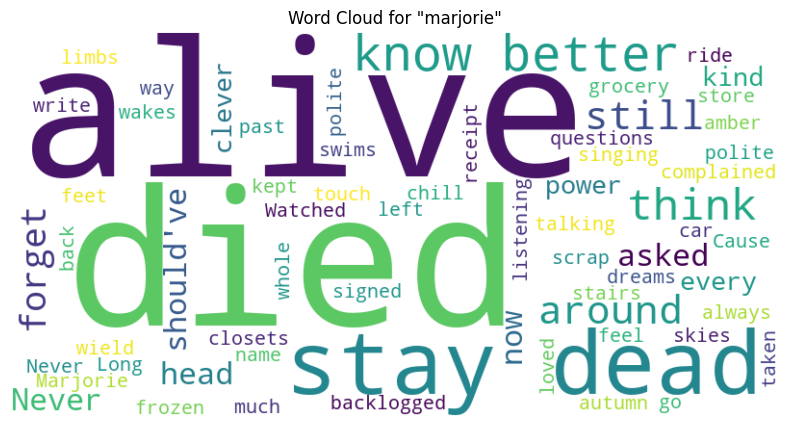

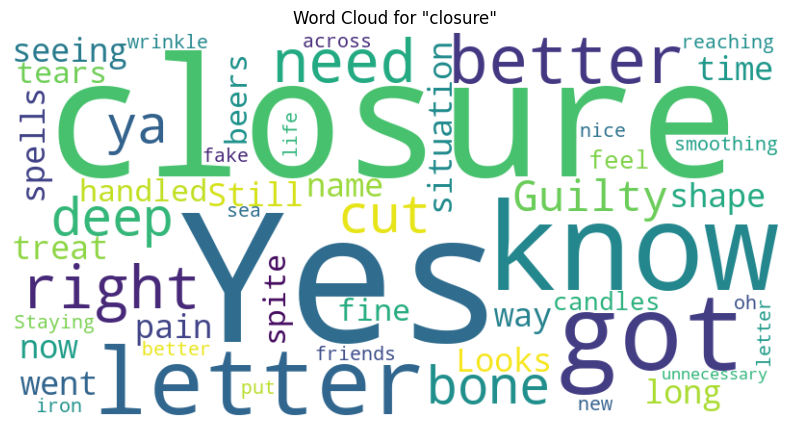

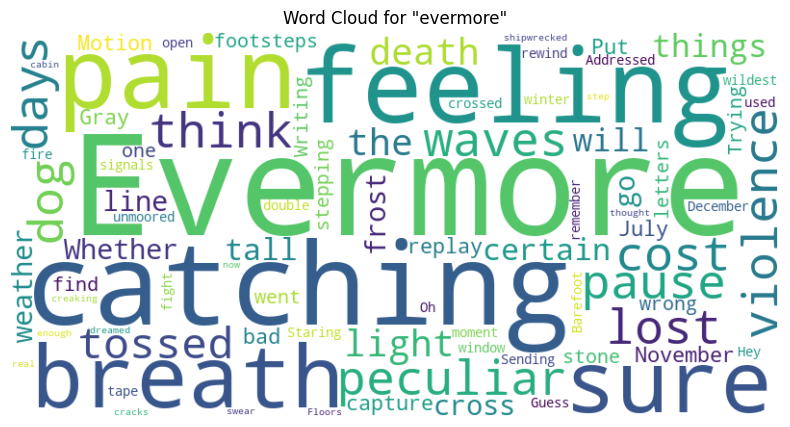

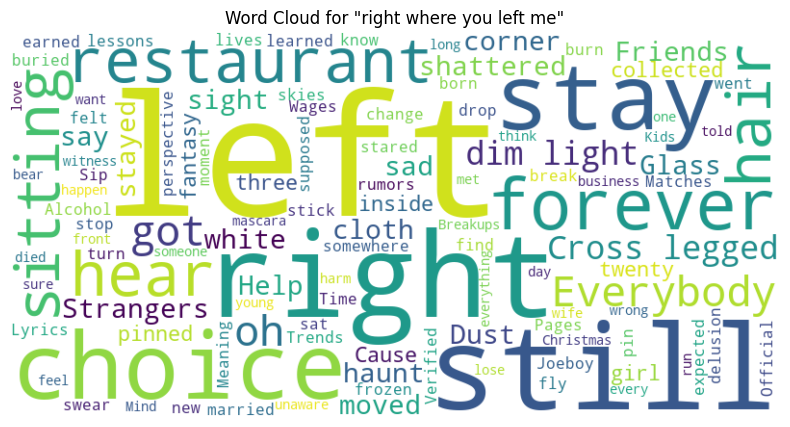

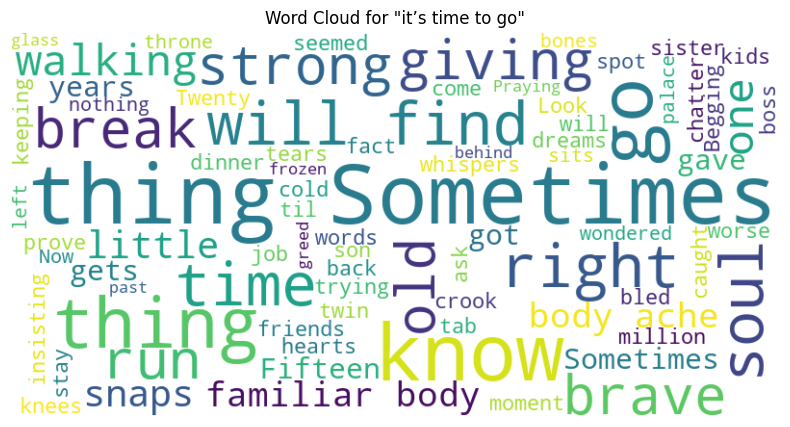

In [10]:
# se obtienen los titulos de las cancioens 
unique_songs = df_songs['track_title'].unique()
# Se repite lo anterior pero para cada canción única

for song in unique_songs:
    lyrics = ' '.join(df_songs[df_songs['track_title'] == song]['lyric'])
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(lyrics)

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'Word Cloud for "{song}"')
    plt.axis('off')
    plt.show()
